In [1]:
import matplotlib as mpl
mpl.rcParams['animation.embed_limit'] = 50  # limit in MB

In [2]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.models as models
import torchvision.transforms as transforms
from PIL import Image
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import numpy as np

# Set device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


### 1. Define the Feature Extractor

In [13]:
class VGGFeatures(nn.Module):
    """
    Extracts features up to a certain layer index in VGG19. 
    For example, conv4_1 is at index 21 in torchvision.models.vgg19(pretrained=True).features.
    """
    def __init__(self, selected_layer=1):
        super(VGGFeatures, self).__init__()
        self.vgg = models.vgg19(pretrained=True).features.to(device).eval()
        self.selected_layer = selected_layer

    def forward(self, x):
        for i, layer in enumerate(self.vgg):
            x = layer(x)
            if i == self.selected_layer:
                return x

# Instantiate the feature extractor for conv4_1
feature_extractor = VGGFeatures(selected_layer=21)

c:\Users\lenovo\anaconda3\envs\torchenv\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\lenovo\anaconda3\envs\torchenv\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


### 2. Define Preprocessing and Load the Original Image

In [14]:
mean = [0.485, 0.456, 0.406]
std  = [0.229, 0.224, 0.225]

preprocess = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=mean, std=std)
])

def denormalize(tensor):
    """De-normalize a tensor for visualization."""
    tensor = tensor.clone().detach().cpu()
    for t, m, s in zip(tensor, mean, std):
        t.mul_(s).add_(m)
    return torch.clamp(tensor, 0, 1)

def load_image(image_path):
    image = Image.open(image_path).convert('RGB')
    image = preprocess(image).unsqueeze(0)  # batch dimension
    return image.to(device)

# Replace 'your_image.jpg' with the path to your image file
original_image = load_image(r'C:\Users\lenovo\Projects\Neural_Style_Transfer\data\content\wallhaven-9d9g38.jpg')

In [15]:
# Create a noise image of the same shape as the original
noise_image = torch.randn_like(original_image, device=device, requires_grad=True)

# Extract features of the original image (target)
with torch.no_grad():
    target_features = feature_extractor(original_image)

In [16]:
def content_loss_func(gen_feats, tgt_feats):
    """
    Implements the formula:
        L_content = 1/2 * sum_ij((F_ij^l - P_ij^l)^2)
    where F_ij^l are the features of the generated image,
    and P_ij^l are the features of the original image at layer l.
    """
    # We multiply by 0.5 to match the exact formula in your image,
    # but in practice you can omit it and just use MSE if you prefer.
    return 0.5 * torch.sum((gen_feats - tgt_feats) ** 2)

In [17]:
optimizer = optim.LBFGS([noise_image], lr=1.0, max_iter=50, history_size=10)

num_iterations = 200
result_images = []

print("Starting LBFGS optimization...")

for i in range(num_iterations):
    def closure():
        optimizer.zero_grad()
        # Extract features from the noise image
        gen_features = feature_extractor(noise_image)
        # Compute explicit content loss
        loss = content_loss_func(gen_features, target_features)
        loss.backward()
        return loss

    loss = optimizer.step(closure)
    
    # Store intermediate results for animation every 5 iterations
    if i % 5 == 0 or i == num_iterations - 1:
        vis_img = denormalize(noise_image.squeeze(0))
        result_images.append(np.transpose(vis_img.numpy(), (1, 2, 0)))
    
    if (i+1) % 20 == 0:
        print(f"Iteration {i+1}/{num_iterations}, Loss: {loss.item():.4f}")

print("LBFGS Optimization finished.")

Starting LBFGS optimization...
Iteration 20/200, Loss: 110464.1719
Iteration 40/200, Loss: 69244.4531
Iteration 60/200, Loss: 55775.5938
Iteration 80/200, Loss: 48633.2031
Iteration 100/200, Loss: 43565.7500
Iteration 120/200, Loss: 39490.3164
Iteration 140/200, Loss: 36213.9609
Iteration 160/200, Loss: 33450.7656
Iteration 180/200, Loss: 31094.1836
Iteration 200/200, Loss: 28918.8633
LBFGS Optimization finished.


In [20]:
fig, ax = plt.subplots(figsize=(6,6))
im = ax.imshow(result_images[0])
ax.axis('off')
ax.set_title("Optimized Image Progression (LBFGS)")

def update(frame):
    im.set_array(result_images[frame])
    ax.set_title(f"Iteration {frame*5}")
    return [im]

anim = FuncAnimation(fig, update, frames=len(result_images), interval=100, blit=True)
plt.close()  # prevent duplicate display in some environments

# Increase embed limit if needed
import matplotlib as mpl
mpl.rcParams['animation.embed_limit'] = 50  # 50 MB limit (adjust as needed)

from IPython.display import HTML
HTML(anim.to_jshtml())

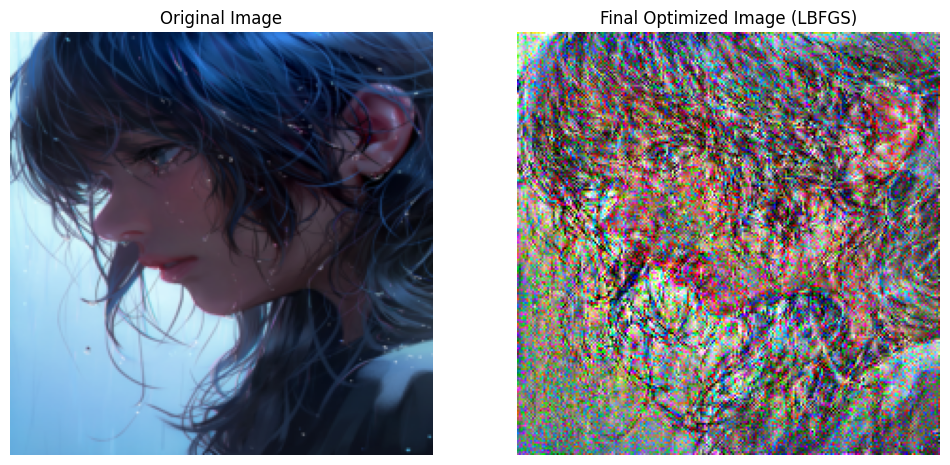

In [19]:
fig, axs = plt.subplots(1, 2, figsize=(12, 6))

# Original
orig_vis = denormalize(original_image.squeeze(0))
axs[0].imshow(np.transpose(orig_vis.numpy(), (1, 2, 0)))
axs[0].set_title("Original Image")
axs[0].axis('off')

# Final
final_vis = result_images[-1]
axs[1].imshow(final_vis)
axs[1].set_title("Final Optimized Image (LBFGS)")
axs[1].axis('off')

plt.show()